# Imports

In [50]:
import pandas as pd
import plotly.express as px

# Reading dataframe

In [51]:
df = pd.read_csv("../data/processed_data/train.csv")

/var/folders/1r/ndm52t3d58j7bkp7_dx_ygc00000gn/T/ipykernel_5314/540487812.py:1: DtypeWarning:

Columns (20) have mixed types. Specify dtype option on import or set low_memory=False.



In [52]:
df2=pd.read_csv("../data/raw_data/historical_flights.csv")

In [53]:
df2.head()

,flight_id,dep_airport,dep_airport_group,arr_airport,arr_airport_group,service_type,std,sta,cancelled,atd,ata
0,WF149,HOV,B,OSL,NaN,J,2018-01-02T16:40:00.000000,2018-01-02T17:15:00.000000,0,NaN,2018-01-02T18:53:00.000000
1,WF722,OSL,NaN,MJF,D,J,2018-01-28T13:04:00.000000,2018-01-28T14:50:00.000000,0,NaN,NaN
2,WF188,FDE,A,OSL,NaN,J,2018-04-07T07:10:00.000000,2018-04-07T08:10:00.000000,0,NaN,2018-04-07T07:55:00.000000
3,WF176,HOV,B,OSL,NaN,J,2018-04-07T11:00:00.000000,2018-04-07T12:05:00.000000,0,NaN,2018-04-07T12:00:00.000000
4,WF148,HOV,B,OSL,NaN,J,2018-04-30T08:25:00.000000,2018-04-30T09:26:00.000000,0,NaN,2018-04-30T09:36:00.000000


## Wrong data

In [54]:
df2['std'] = pd.to_datetime(df2['std'])
df2['sta'] = pd.to_datetime(df2['sta'])
df2['duration'] = df2['sta'] - df2['std']
dfwrong = df2[df2['duration'] > pd.Timedelta(hours=10)]



In [55]:
dfwrong

,flight_id,dep_airport,dep_airport_group,arr_airport,arr_airport_group,service_type,std,sta,cancelled,atd,ata,duration
10146,WF976,TOS,NaN,VDS,G,J,2018-03-02 16:20:00,2018-03-21 17:27:00,0,2018-03-02T17:00:00.000000,2018-03-02T18:15:00.000000,19 days 01:07:00
85575,WF977,VDS,G,VAW,F,J,2019-02-12 20:35:00,2019-02-15 20:55:00,0,NaN,NaN,3 days 00:20:00
91868,ZH847,AES,NaN,RVK,C,W,2019-06-27 09:30:00,2019-07-26 11:10:00,0,NaN,NaN,29 days 01:40:00
101210,WF977,BVG,F,TOS,NaN,J,2019-11-12 22:25:00,2019-11-13 23:35:00,0,NaN,NaN,1 days 01:10:00
167395,WF999,BGO,NaN,VDS,G,J,2021-03-19 10:02:00,2021-03-19 22:45:00,0,2021-03-19T10:30:00.000000,NaN,0 days 12:43:00
229698,DY9977,OSL,NaN,VDS,G,J,2022-01-13 11:30:00,2022-01-13 22:22:00,1,NaN,NaN,0 days 10:52:00


In [56]:
df2['atd'] = pd.to_datetime(df2['atd'])
df2['std'] = pd.to_datetime(df2['std'])
df2['sta'] = pd.to_datetime(df2['sta'])
df2['ata'] = pd.to_datetime(df2['ata'])

df2['delay_min_departure'] = (df2['atd'] - df2['std']).dt.total_seconds() / 60
df2['delay_min_arrival'] = (df2['ata'] - df2['sta']).dt.total_seconds() / 60
px.histogram(df2, x="delay_min_departure", nbins=100, title="Histogram of Departure Delays (in minutes)").show()
px.histogram(df2, x="delay_min_arrival", nbins=100, title="Histogram of Arrival Delays (in minutes)").show()

In [57]:
dfwrong2 = df2[df2['delay_min_departure'].abs() > 500]
dfwrong2

,flight_id,dep_airport,dep_airport_group,arr_airport,arr_airport_group,service_type,std,sta,cancelled,atd,ata,duration,delay_min_departure,delay_min_arrival
4107,WF827,SVJ,E,BOO,NaN,J,2018-01-24 06:10:00,2018-01-24 06:35:00,0,2018-01-23 17:41:00,2018-01-24 06:28:00,0 days 00:25:00,-749.0,-7.0
9682,WF974,MEH,G,BVG,F,J,2018-02-22 11:35:00,2018-02-22 11:53:00,0,2018-02-21 22:23:00,2018-02-22 11:45:00,0 days 00:18:00,-792.0,-8.0
11851,WF186,FDE,A,OSL,NaN,J,2018-03-12 05:30:00,2018-03-12 06:30:00,0,2018-03-11 18:38:00,2018-03-12 06:35:00,0 days 01:00:00,-652.0,5.0
12358,WF773,MQN,D,BOO,NaN,J,2018-03-04 15:20:00,2018-03-04 15:50:00,0,2018-03-03 15:34:00,2018-03-04 16:00:00,0 days 00:30:00,-1426.0,10.0
13125,WF984,HFT,NaN,VDS,G,J,2018-03-13 22:28:00,2018-03-13 23:13:00,0,2018-03-12 23:02:00,2018-03-13 23:23:00,0 days 00:45:00,-1406.0,10.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
362822,SK9156A,OSL,NaN,SOJ,C,J,2024-09-04 06:55:00,2024-09-04 10:00:00,0,2024-09-03 09:31:00,NaT,0 days 03:05:00,-1284.0,NaN
365934,WF175,OSL,NaN,HOV,B,J,2024-12-04 18:05:00,2024-12-04 19:15:00,1,2024-12-03 19:00:00,NaT,0 days 01:10:00,-1385.0,NaN
379714,WF763,MQN,D,TRD,NaN,J,2024-09-02 04:25:00,2024-09-02 05:30:00,1,2024-09-02 13:42:00,NaT,0 days 01:05:00,557.0,NaN
381669,QS4315,MOL,B,PRG,NaN,C,2024-12-20 01:00:00,2024-12-20 03:45:00,0,2024-12-20 09:22:00,NaT,0 days 02:45:00,502.0,NaN


In [58]:
px.histogram(df2, x="std",y='delay_min_departure', nbins=100, title="Histogram of Departure Delays (in minutes)").show()

## Exploration

In [59]:
df.head()

,airport_group,timestamp,target_actual,target_sched,flights_cnt,avg_duration,max_duration,passenger_share,cargo_share,charter_share,...,dow,holiday,month,hournum,weekend,date,daily_flights_cnt,flights_cnt_prev,flights_cnt_next,weather
0,B,2018-01-01 07:00:00,0,0,0,0.0,0.0,0.0,0.0,0.0,...,0,True,1,7,0,2018-01-01,34,0,0,"{'@context': 'https://frost.met.no/schema', '@..."
1,F,2018-01-01 07:00:00,0,0,0,0.0,0.0,0.0,0.0,0.0,...,0,True,1,7,0,2018-01-01,23,0,0,NaN
2,A,2018-01-01 07:00:00,0,0,0,0.0,0.0,0.0,0.0,0.0,...,0,True,1,7,0,2018-01-01,25,0,0,NaN
3,C,2018-01-01 07:00:00,0,1,2,27.5,35.0,1.0,0.0,0.0,...,0,True,1,7,0,2018-01-01,28,0,4,NaN
4,G,2018-01-01 07:00:00,0,0,0,0.0,0.0,0.0,0.0,0.0,...,0,True,1,7,0,2018-01-01,29,0,0,NaN


# Map of airports

In [68]:
df_airports=pd.read_csv("../data/raw_data/airportgroups.csv")
df_airports.head()

,airport_group,airport
0,A,FDE
1,A,SDN
2,A,SOG
3,B,HOV
4,B,MOL


In [69]:
df_airport_info= pd.read_csv("../data/raw_data/airports.csv")
df_airport_info.head()

,id,ident,type,name,latitude_deg,longitude_deg,elevation_ft,continent,iso_country,iso_region,municipality,scheduled_service,icao_code,iata_code,gps_code,local_code,home_link,wikipedia_link,keywords
0,6523,00A,heliport,Total RF Heliport,40.070985,-74.933689,11.0,NaN,US,US-PA,Bensalem,no,NaN,NaN,K00A,00A,https://www.penndot.pa.gov/TravelInPA/airports...,NaN,NaN
1,323361,00AA,small_airport,Aero B Ranch Airport,38.704022,-101.473911,3435.0,NaN,US,US-KS,Leoti,no,NaN,NaN,00AA,00AA,NaN,NaN,NaN
2,6524,00AK,small_airport,Lowell Field,59.947733,-151.692524,450.0,NaN,US,US-AK,Anchor Point,no,NaN,NaN,00AK,00AK,NaN,NaN,NaN
3,6525,00AL,small_airport,Epps Airpark,34.864799,-86.770302,820.0,NaN,US,US-AL,Harvest,no,NaN,NaN,00AL,00AL,NaN,NaN,NaN
4,506791,00AN,small_airport,Katmai Lodge Airport,59.093287,-156.456699,80.0,NaN,US,US-AK,King Salmon,no,NaN,NaN,00AN,00AN,NaN,NaN,NaN


In [74]:
df_airports_with_pos = df_airports.merge(df_airport_info[['iata_code', 'latitude_deg', 'longitude_deg']], left_on='airport', right_on='iata_code', how='left').drop(columns=['iata_code'])

In [75]:
df_airports_with_pos

,airport_group,airport,latitude_deg,longitude_deg
0,A,FDE,61.391102,5.756940
1,A,SDN,61.830002,6.105830
2,A,SOG,61.156101,7.137780
3,B,HOV,62.180000,6.074100
4,B,MOL,62.744701,7.262500
5,B,RRS,62.578400,11.342300
6,C,OSY,64.472198,11.578600
7,C,RVK,64.838303,11.146100
8,C,SOJ,69.786797,20.959400
9,D,MJF,65.783997,13.214900


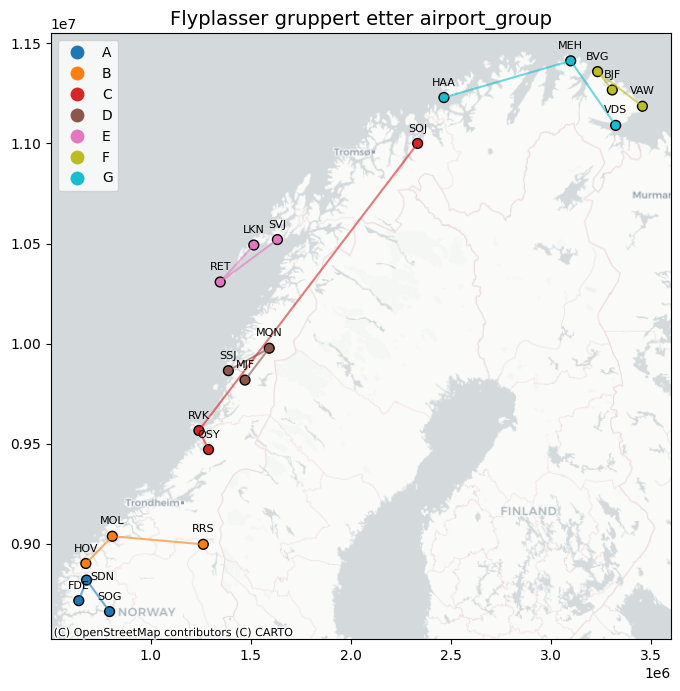

In [110]:
import geopandas as gpd
from shapely.geometry import Point, LineString
import contextily as ctx
import matplotlib.pyplot as plt

# Konverter til GeoDataFrame (punkter)
gdf = gpd.GeoDataFrame(
    df_airports_with_pos,
    geometry=gpd.points_from_xy(df_airports_with_pos.longitude_deg, df_airports_with_pos.latitude_deg),
    crs="EPSG:4326"
).to_crs("EPSG:3857")

# Lag linjer mellom flyplasser i samme group
lines = []
for group, group_df in gdf.groupby("airport_group"):
    if len(group_df) > 1:
        line = LineString(group_df.geometry.tolist())
        lines.append({"airport_group": group, "geometry": line})

gdf_lines = gpd.GeoDataFrame(lines, crs=gdf.crs)

# Plot punkter og linjer
fig, ax = plt.subplots(figsize=(8, 10))

# Linjer
gdf_lines.plot(ax=ax, column="airport_group", cmap="tab10", linewidth=1.5, alpha=0.6, legend=False)

# Punkter
gdf.plot(ax=ax, column="airport_group", cmap="tab10", markersize=50, edgecolor="black", legend=True)

# Tekstlabels (flyplasskoder)
for x, y, label in zip(gdf.geometry.x, gdf.geometry.y, gdf["airport"]):
    if(label=='SDN'):
        ax.text(x+80000, y, label, fontsize=8, ha="center", color="black")
    else:
        ax.text(x, y + 60000, label, fontsize=8, ha="center", color="black")  
    # y + 20000 flytter label litt over punktet (20000 ≈ 20 km i EPSG:3857)

# Basemap
ctx.add_basemap(ax, source=ctx.providers.CartoDB.Positron)

plt.title("Flyplasser gruppert etter airport_group", fontsize=14)
plt.show()


## Forsinkelser

In [140]:
df_flights=pd.read_csv("../data/raw_data/historical_flights.csv")
df_flights['delay_min_departure'] = (pd.to_datetime(df_flights['atd']) - pd.to_datetime(df_flights['std'])).dt.total_seconds() / 60
df_flights['delay_min_arrival'] = (pd.to_datetime(df_flights['ata']) - pd.to_datetime(df_flights['sta'])).dt.total_seconds() / 60
df_flights['avg_delay_arrival_departure'] = (df_flights['delay_min_arrival'] + df_flights['delay_min_departure']) / 2
df_flights_noExtremes = df_flights[df_flights['avg_delay_arrival_departure'].abs() < 40]
px.histogram(df_flights_noExtremes, x="avg_delay_arrival_departure", nbins=100)

In [143]:
from scipy import stats
data = df_flights_noExtremes["avg_delay_arrival_departure"]

# Fit ulike fordelinger
params_norm = stats.norm.fit(data)
params_t = stats.t.fit(data)
params_skew = stats.skewnorm.fit(data)

# Beregn log-likelihood
ll_norm = np.sum(stats.norm.logpdf(data, *params_norm))
ll_t = np.sum(stats.t.logpdf(data, *params_t))
ll_skew = np.sum(stats.skewnorm.logpdf(data, *params_skew))

print("Log-likelihood normal:", ll_norm)
print("Log-likelihood t:", ll_t)
print("Log-likelihood skew normal:", ll_skew)

Log-likelihood normal: -1436364.08952235
Log-likelihood t: -1421619.6488181255
Log-likelihood skew normal: -1421460.9658980446


In [149]:
import numpy as np
import plotly.express as px
import plotly.graph_objects as go
from scipy.stats import t

# Data
data = df_flights_noExtremes["avg_delay_arrival_departure"]

# Fit t-fordeling
df_t, loc_t, scale_t = t.fit(data)  # df=grader av frihet, loc=mu, scale=sigma

# Histogram normalisert til tetthet
fig = px.histogram(
    data,
    nbins=200,
    histnorm="probability density",
    opacity=0.6
)

# x-verdier og pdf for t-fordeling
x_vals = np.linspace(data.min(), data.max(), 500)
pdf_t = t.pdf(x_vals, df_t, loc_t, scale_t)

# Legg til t-fordelingskurve
fig.add_trace(go.Scatter(
    x=x_vals,
    y=pdf_t,
    mode="lines",
    name=f"t-fordeling (df={df_t:.1f}, μ={loc_t:.2f}, σ={scale_t:.2f})",
    line=dict(color="green", width=2)
))

fig.update_layout(
    title="Histogram av forsinkelse for avgang og landing for alle fly tilpasset t-fordeling",
    xaxis_title="Forsinkelse (minutter)",
    yaxis_title="Tetthet"
)

fig.show()


In [130]:
mu = df_flights_noExtremes["avg_delay_arrival_departure"].mean()
sigma = df_flights_noExtremes["avg_delay_arrival_departure"].std()
print(mu, sigma)

1.2119365967989668 15.66983881545376


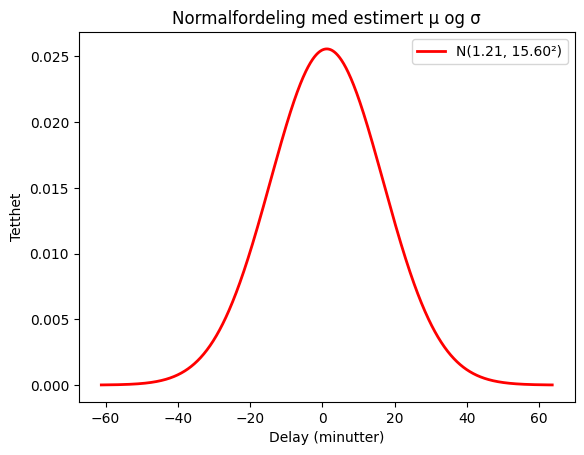

In [133]:
# Eksempelverdier (bytt ut med dine faktiske)
import numpy as np
from scipy.stats import norm
mu = 1.2119365967989668     # gjennomsnitt
sigma = 15.6 # standardavvik

# Lag x-akse rundt dataen
x = np.linspace(mu - 4*sigma, mu + 4*sigma, 1000)

# Beregn sannsynlighetstettheten (pdf)
pdf = norm.pdf(x, mu, sigma)

# Plot normalfordeling
plt.plot(x, pdf, 'r-', linewidth=2, label=f'N({mu:.2f}, {sigma:.2f}²)')
plt.title("Normalfordeling med estimert μ og σ")
plt.xlabel("Delay (minutter)")
plt.ylabel("Tetthet")
plt.legend()
plt.show()